In [2]:
from requests_html import AsyncHTMLSession, HTMLSession
from bs4 import BeautifulSoup
import asyncio
import logging
import json
import time
import re

logging.disable(logging.WARNING)

In [3]:
def debug_print(message, debug=True):
    
    if debug:
        print(message)

def convert_keys_to_int(json_dict):
    
    return { (int(key) if key.isdigit() else key): value for key, value in json_dict.items() }

def load_json(path, edition=None, articles=None):
    
    try:
        with open(path + '.json', 'r', encoding='utf-8') as file:
            return json.load(file, object_hook=convert_keys_to_int)

    except (FileNotFoundError, json.JSONDecodeError):
        with open(path + '.json', 'w', encoding='utf-8') as file:
            json.dump({ }, file, ensure_ascii=False, indent=4)
        return { }

def save_json(path, entries, edition=None, reset=False):
    
    temp_entries = entries   
    entries = ({ edition: { } } if edition else { }) if reset else load_json(path)

    (entries[edition] if edition else entries).update(temp_entries)
    
    try:
        with open(path + '.json', 'w', encoding='utf-8') as file:
            json.dump(entries, file, ensure_ascii=False, indent=4)

    except:
        pass
        
def find_missing_articles(edition, articles, path):

    return articles - load_json(path).get(edition, { }).keys()

In [159]:
async def fetch_article(
    edition, article, session=AsyncHTMLSession(), semaphore=asyncio.Semaphore(), max_tries=5, debug=False):
    
    url = f'https://nordiskfamiljebok.dh.gu.se/article/{edition}/{article}'
    
    async with semaphore:

        debug_print(f"Fetching {'1st' if article == 1 else f'{article}nd'} article from {'1st' if edition == 1 else f'{edition}nd'} edition", debug)
        
        for n in range(1, max_tries + 1):
            try:
                response = await session.get(url)
                await response.html.arender(timeout=5*n, sleep=5*n)
                
                debug_print(f"Successfully fetched article {article}, {'1st' if edition == 1 else f'{edition}nd'} edition", debug)
                
                return response.html
                
            except:
                debug_print(f"Failed to fetch article {article}, {'1st' if edition == 1 else f'{edition}nd'} edition.\nRetrying with larger timeout...", debug)
    
    debug_print(f"Failed to fetch article {article}, {'1st' if edition == 1 else f'{edition}nd'} edition", debug)
     
    return None

async def fetch_articles(
    edition, articles, path='articles', force_fetch=False,
    max_concurrent_tasks=5, max_tries=5, debug=False):
    
    if not force_fetch:
        articles = find_missing_articles(edition, articles, path)

    session = AsyncHTMLSession()
    semaphore = asyncio.Semaphore(max_concurrent_tasks)
    
    async with asyncio.TaskGroup() as task_group:
        tasks = [
            task_group.create_task(
                fetch_article(edition, article, session, semaphore, max_tries, debug))
            for article in articles
        ]

    entries = { edition: { } }
    
    for (task, article) in zip(tasks, articles):
        
        try:
            html = task.result().html 
            soup = BeautifulSoup(html, "html.parser")

            entries[edition][article] = {
                'html': html,
                'title': soup.find('h1', {'data-v-5ad7308b': True}).decode_contents(),
                'text': soup.find('article', {'data-v-5ad7308b': True}).decode_contents()
                }
        except:
            pass

    return entries

async def load_articles(
    edition, articles, path='articles', force_fetch=False,
    max_concurrent_tasks=5, sort=False, max_tries=5, debug=False):
    
    entries = load_json(path)
    entries.setdefault(edition, { })
    
    print(entries)
    
    fetched_entries = await fetch_articles(
        edition, articles, path, force_fetch, max_concurrent_tasks, max_tries, debug)
    
    entries[edition].update(fetched_entries.get(edition, { }))

    if sort:
        entries = { key: dict(sorted(value.items())) for key, value in sorted(entries.items()) }

    save_json(path, entries)

    return { key: value for values in entries.values() for key, value in values.items() if key in articles}

In [172]:
import unicodedata
import locale

locale.setlocale(locale.LC_COLLATE, 'sv_SE.UTF-8')

def segment_text(entry, edition=None, article=None):

    '''
    segments = re.split(r"\s*(?:<br\s*/?>)+\s*", text)

    last_valid_segment = None
    last_valid_word = None
    valid_segments = {}

    for segment in segments:
        # segment = unicodedata.normalize('NFC', segment)
        clean_segment = re.sub(r"<.*?>", '', segment).strip().lower()

        try:
            first_word = re.match(r"\b(\w[\w']*)", clean_segment).group(0)  # Match the first word
            first_word_uml = re.sub(r'ii', 'ü', first_word)
        except:
            first_word = first_word_uml = ''

        if last_valid_segment:

            if (last_valid_word < first_word or last_valid_word < first_word_uml
                and (re.match(r"[\w'-]+[\s]*[.,\(\[]", clean_segment))):
                valid_segments[last_valid_word] = last_valid_segment
                last_valid_segment = clean_segment
                last_valid_word = first_word
                #print("NEW -", "HEAD:", first_word, "SEGMENT:", clean_segment)

            else:
                last_valid_segment += '\n' + clean_segment
                #print("OLD -", "HEAD:", first_word, "SEGMENT:", clean_segment)
        else:
            #print("NEW -", "HEAD:", first_word, "SEGMENT:", clean_segment)
            last_valid_segment = clean_segment
            last_valid_word = first_word

    valid_segments[last_valid_word] = last_valid_segment
    
    return valid_segments
    '''
    return {'header': entry['title'], 'text': entry['text']}
async def load_segments(
    edition, articles, articles_path='articles', segments_path='segments',
    force_fetch=False, max_concurrent_tasks=10, sort=False,
    max_tries=5, force_segmentation=False, debug=False):
    
    segmentations = load_json(segments_path)  
    segmentations.setdefault(edition, { })
    
    if force_segmentation:
        articles = find_missing_articles(edition, articles, segments_path)

    entries = (await load_articles(
        edition, articles, articles_path, force_fetch, max_concurrent_tasks, sort, max_tries, debug))
 
    for article in articles:
        text = entries[article]['text']
        
        entries[edition][article] = [
            {
                'head': head,
                'segment': segment,
                'label': 'Other'
            } for head, segment in segment_text(text).items()
        ]
            
    if sort:
        entries = { key: dict(sorted(value.items())) for key, value in sorted(entries.items()) } 

    save_json(segments_path, entries)

    return { key: value for values in entries.values() for key, value in values.items() if key in articles}

In [162]:
edition = 2
articles = range(1, 1001)

article_entries = await load_articles(edition, articles, sort=True)
#segment_entries = await load_segments(edition, articles, sort=True, force_segmentation=True)

{1: {1: {'text': '<b>A</b> är den första <i>bokstafven</i> i alla indoeuropeiska språks alfabet utom i den vanliga runföljden, der det innehar det tionde rummet. Det är tillika det renaste och klaraste af alla <i>språkljud</i> och har på ljudskalan sin plats mellan <i>I</i> och <i>U</i>, med hvilka vokaler det omvexlande förekommer dels i olika språk af samma stam i beteckningar af lika eller närstående begrepp, t.ex. Sanskr. <i>agni</i>, Lat. <i>ignis</i>, Littau. <i>ugnis</i> (hvilka alla betyda eld), Sv. <i>ugn</i>, dels i ett och samma språk vid ordböjning (<i>finna, fann, funnen</i>) eller ordbildning (<i>bindel, band, bundt</i>). Svenskan eger ett kort och öppet <i>a</i>, t. ex. i <i>grann</i>, <i>kall</i>, samt ett långt och slutet, t. ex. i <i>gran</i>, <i>kal</i>. I de nyare språken och icke minst i vårt eget, särdeles i våra landskapsmål, visar <i>a</i> benägenhet att sjunka och fördunklas till mer eller mindre grumliga <i>ä-</i> (<i>e-</i>) eller <i>å-</i>ljud, t. ex. <i>svä

In [173]:
segments = await load_segments(edition, range(1, 6), sort=True)


{1: {1: {'text': '<b>A</b> är den första <i>bokstafven</i> i alla indoeuropeiska språks alfabet utom i den vanliga runföljden, der det innehar det tionde rummet. Det är tillika det renaste och klaraste af alla <i>språkljud</i> och har på ljudskalan sin plats mellan <i>I</i> och <i>U</i>, med hvilka vokaler det omvexlande förekommer dels i olika språk af samma stam i beteckningar af lika eller närstående begrepp, t.ex. Sanskr. <i>agni</i>, Lat. <i>ignis</i>, Littau. <i>ugnis</i> (hvilka alla betyda eld), Sv. <i>ugn</i>, dels i ett och samma språk vid ordböjning (<i>finna, fann, funnen</i>) eller ordbildning (<i>bindel, band, bundt</i>). Svenskan eger ett kort och öppet <i>a</i>, t. ex. i <i>grann</i>, <i>kall</i>, samt ett långt och slutet, t. ex. i <i>gran</i>, <i>kal</i>. I de nyare språken och icke minst i vårt eget, särdeles i våra landskapsmål, visar <i>a</i> benägenhet att sjunka och fördunklas till mer eller mindre grumliga <i>ä-</i> (<i>e-</i>) eller <i>å-</i>ljud, t. ex. <i>svä

In [174]:
segments

{1: {'text': '<b>A</b> är den första bokstafven i det vanliga europeisk-latinska alfabetet. Dess äldsta kända, semitisk-moabitiska, form är [*]; äldre grekiska alfabet hafva mest [*] eller [*], men äfven A; i italiska inskrifter (latinska och etruskiska) finnas [* * * A], hvilken sista form efter hand blef förhärskande. Från en yngre form, [*], som finnes i grekiska och latinska handskrifter (redan papyrusar), härstamma den kirilliska (fornslaviska) och den koptiska formen samt vårt a; äfven det gotiska alfabetets [*] har sin motsvarighet i grekisk kursivskrift. Försök att skrifva bokstafven i ett drag ledde redan i grekisk kursivskrift till såväl',
  'title': 'A',
  'url': 'https://nordiskfamiljebok.dh.gu.se/article/2/117910'},
 2: {'text': '<i>a</i> som [alfa]. Ur <b>a</b> utvecklas i 13:de årh. en form, som i det närmaste sammanfaller med frakturens a. Från de italiska formerna härstammar den äldre runskriftens [*]. Den yngre run-radens <i>a</i>-tecken var [*] (och [*]), som växlat 

In [6]:
import pandas as pd
import keyboard
import time

idx2cat = {
    0: 'Undefined',
    1: 'Person',
    2: 'Location',
    3: 'Other'
}

#splits = {'train': 'train.json', 'validation': 'validation.json'}
#df = pd.read_json("hf://datasets/pnugues/nf_1876/" + splits["train"])
df = pd.read_csv('annotations.csv', index_col=0)

i = 0
last_i = -1

filtered_df = df[df['label'] == 0].index

exit = False

actions = {
    '1': 'Label as location',
    '2': 'Label as other',
    '3': 'Go back one step',
    '4': 'Save',
    '5': 'Exit'
}


print('Inputs:\n')

for key, action in actions.items():
    print(f'{key}. {action}')

print()

while (True):
    
    item = df.loc[filtered_df[i]]
    
    text = item['text']
    label = item['label']
    
    if last_i != i:
        print(f'{i+1}/{len(filtered_df)}:\nText: {text}\nLabel: {idx2cat[label]}\n')

    last_i = i
    
    key_press = keyboard.read_key()

    if key_press in actions.keys():
        print(f'You chose \'{actions[key_press]}\'\n')
    
    if key_press in { '1', '2'}:
        df.loc[filtered_df[i], 'label'] = int(key_press) + 1
        i = min(i + 1, len(df) - 1)
        
    if key_press == '3':
        i = max(i - 1, 0)
    
    if key_press == '4':
        df.to_csv('annotations_edited.csv', index=False)
        
    if key_press == "5":
        break
    
    time.sleep(0.2)

Inputs:

1. Label as location
2. Label as other
3. Go back one step
4. Save
5. Exit

1/200:
Text: <b>Apprehension</b> (Lat. apprehénsio, af <i>apprehéndere</i>), <i>jur.,</i> den handling, hvarigenom en person tager en sak i besittning.
Label: Undefined

You chose 'Exit'



In [86]:
from datasets import Dataset
import pandas as pd

df = pd.read_csv('annotations_edited.csv', index_col=0)

segments = df[df['label'] != 0]

segments.loc[:, 'label'] = segments['label'] - 1

segments = Dataset.from_pandas(segments)
segments = segments.train_test_split(test_size=0.2)
segments

DatasetDict({
    train: Dataset({
        features: ['label', 'text'],
        num_rows: 320
    })
    test: Dataset({
        features: ['label', 'text'],
        num_rows: 80
    })
})

In [87]:
from transformers import AutoTokenizer

tokenizer = AutoTokenizer.from_pretrained('KB/bert-base-swedish-cased')

def tokenize(batch):
    return tokenizer(batch["text"], padding=True, truncation=True)

In [88]:
segments_encoded = segments.map(tokenize, batched=True, batch_size=None)

Map:   0%|          | 0/320 [00:00<?, ? examples/s]

Map:   0%|          | 0/80 [00:00<?, ? examples/s]

In [8]:
from transformers import AutoModelForSequenceClassification

num_labels = 3

model = (AutoModelForSequenceClassification
         .from_pretrained('KB/bert-base-swedish-cased', num_labels=num_labels))

C:\Users\kalls\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\torchvision\datapoints\__init__.py:12: UserWarning: The torchvision.datapoints and torchvision.transforms.v2 namespaces are still Beta. While we do not expect major breaking changes, some APIs may still change according to user feedback. Please submit any feedback you may have in this issue: https://github.com/pytorch/vision/issues/6753, and you can also check out https://github.com/pytorch/vision/issues/7319 to learn more about the APIs that we suspect might involve future changes. You can silence this warning by calling torchvision.disable_beta_transforms_warning().
  warnings.warn(_BETA_TRANSFORMS_WARNING)
C:\Users\kalls\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\torchvision\transforms\v2\__init__.py:54: UserWarning: The torchvision.datapoints and torchvision.transfo

In [9]:
from sklearn.metrics import accuracy_score, f1_score

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    f1 = f1_score(labels, preds, average="weighted")
    acc = accuracy_score(labels, preds)
    return {"accuracy": acc, "f1": f1}

In [12]:
from transformers import Trainer, TrainingArguments

batch_size = 16
logging_steps = 1# len(segments_encoded) // batch_size
model_name = f"bert-finetuned-segments"
training_args = TrainingArguments(output_dir=model_name,
                                  num_train_epochs=2,
                                  learning_rate=2e-5,
                                  per_device_train_batch_size=batch_size,
                                  per_device_eval_batch_size=batch_size,
                                  weight_decay=0.01,
                                  evaluation_strategy="epoch",
                                  disable_tqdm=False,
                                  log_level="error")

from transformers import Trainer

trainer = Trainer(model=model, args=training_args, 
                  compute_metrics=compute_metrics,
                  train_dataset=segments_encoded["train"],
                  eval_dataset=segments_encoded["test"],
                  tokenizer=tokenizer)
trainer.train()

C:\Users\kalls\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\transformers\training_args.py:1568: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
C:\Users\kalls\AppData\Local\Temp\ipykernel_68668\2957509027.py:18: FutureWarning: `tokenizer` is deprecated and will be removed in version 5.0.0 for `Trainer.__init__`. Use `processing_class` instead.
  trainer = Trainer(model=model, args=training_args,


  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

{'eval_loss': 0.3175886273384094, 'eval_accuracy': 0.9375, 'eval_f1': 0.9352868852459016, 'eval_runtime': 15.5979, 'eval_samples_per_second': 5.129, 'eval_steps_per_second': 0.321, 'epoch': 1.0}


  0%|          | 0/5 [00:00<?, ?it/s]

{'eval_loss': 0.21138055622577667, 'eval_accuracy': 0.9375, 'eval_f1': 0.9352868852459016, 'eval_runtime': 15.5536, 'eval_samples_per_second': 5.143, 'eval_steps_per_second': 0.321, 'epoch': 2.0}
{'train_runtime': 421.7223, 'train_samples_per_second': 1.518, 'train_steps_per_second': 0.095, 'train_loss': 0.469712495803833, 'epoch': 2.0}


TrainOutput(global_step=40, training_loss=0.469712495803833, metrics={'train_runtime': 421.7223, 'train_samples_per_second': 1.518, 'train_steps_per_second': 0.095, 'total_flos': 28613584177920.0, 'train_loss': 0.469712495803833, 'epoch': 2.0})

In [13]:
preds_output = trainer.predict(segments_encoded["test"])

  0%|          | 0/5 [00:00<?, ?it/s]

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix

labels = ['Person', 'Location', 'Other']

def plot_confusion_matrix(y_preds, y_true, labels):
    cm = confusion_matrix(y_true, y_preds, normalize="true")
    fig, ax = plt.subplots(figsize=(6, 6))
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
    disp.plot(cmap="Blues", values_format=".2f", ax=ax, colorbar=False)
    plt.title("Normalized confusion matrix")
    plt.show()

y_preds = np.argmax(preds_output.predictions, axis=1)
y_valid = np.array(segments_encoded["test"]["label"])

plot_confusion_matrix(y_preds, y_valid, labels)

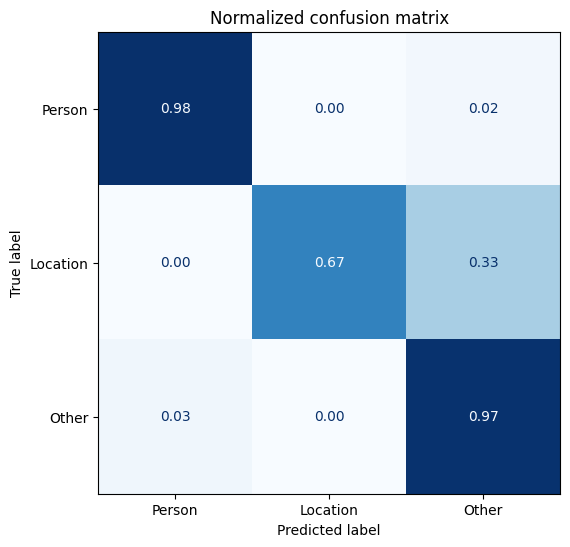

In [14]:
import numpy as np
import matplotlib.pyplot as plt

from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix

labels = ['Person', 'Location', 'Other']

def plot_confusion_matrix(y_preds, y_true, labels):
    cm = confusion_matrix(y_true, y_preds, normalize="true")
    fig, ax = plt.subplots(figsize=(6, 6))
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
    disp.plot(cmap="Blues", values_format=".2f", ax=ax, colorbar=False)
    plt.title("Normalized confusion matrix")
    plt.show()

y_preds = np.argmax(preds_output.predictions, axis=1)
y_valid = np.array(segments_encoded["test"]["label"])

plot_confusion_matrix(y_preds, y_valid, labels)

In [145]:
from qdrant_client import QdrantClient
from qdrant_client.models import VectorParams
from transformers import AutoTokenizer, AutoModel
import torch
import numpy as np

# Initialize KBERT model and tokenizer
model_name = "KB/bert-base-swedish-cased"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModel.from_pretrained(model_name)

def generate_embedding(text):
    inputs = tokenizer(text, return_tensors="pt", padding=True, truncation=True)
    with torch.no_grad():
        outputs = model(**inputs)
        embeddings = outputs.last_hidden_state.mean(dim=1).squeeze().numpy()
    return embeddings

# Example text
texts = ["Det här är ett exempel.", "KBERT är bra för svenska texter.", "Jag heter Christopher"]

# Generate embeddings for the texts
embeddings = [generate_embedding(text) for text in texts]

# Initialize the Qdrant client
qdrant_client = QdrantClient("http://localhost:6333")

# Create Qdrant collection (adjust embedding size as per model)
collection_name = "kb_bert_embeddings"
qdrant_client.recreate_collection(
    collection_name=collection_name,
    vectors_config=VectorParams(size=768, distance="Cosine")  # Update size according to the model
)

# Prepare points with embeddings and texts
points = [
    {"id": i, "vector": embedding.tolist(), "payload": {"text": text}}
    for i, (embedding, text) in enumerate(zip(embeddings, texts))
]

# Insert the points into Qdrant
qdrant_client.upsert(collection_name=collection_name, points=points)
print("Data inserted into Qdrant with embeddings.")


Data inserted into Qdrant with embeddings.


C:\Users\kalls\AppData\Local\Temp\ipykernel_68668\1243971615.py:30: DeprecationWarning: `recreate_collection` method is deprecated and will be removed in the future. Use `collection_exists` to check collection existence and `create_collection` instead.
  qdrant_client.recreate_collection(


In [146]:
hits = qdrant_client.query_points(
    collection_name="kb_bert_embeddings",
    query=generate_embedding("my name is christopher").tolist(),
    limit=3,
).points

for hit in hits:
    print(hit.payload, "score:", hit.score)

{'text': 'Jag heter Christopher'} score: 0.7710086
{'text': 'KBERT är bra för svenska texter.'} score: 0.7545215
{'text': 'Det här är ett exempel.'} score: 0.69857085


In [72]:
hits = client.query_points(
    collection_name="my_books",
    query=encoder.encode("dystopia").tolist(),
    limit=3,
).points

for hit in hits:
    print(hit.payload, "score:", hit.score)

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

{'name': 'Brave New World', 'description': 'A dystopian society where people are genetically engineered and conditioned to conform to a strict social hierarchy.', 'author': 'Aldous Huxley', 'year': 1932} score: 0.6510218498668896
{'name': 'The Hunger Games', 'description': 'A dystopian society where teenagers are forced to fight to the death in a televised spectacle.', 'author': 'Suzanne Collins', 'year': 2008} score: 0.5210286446551736
{'name': 'Snow Crash', 'description': 'A futuristic world where the internet has evolved into a virtual reality metaverse.', 'author': 'Neal Stephenson', 'year': 1992} score: 0.4155045118449123


In [15]:
location_segments = segments.filter(lambda example: example["label"] == 1)

Filter:   0%|          | 0/320 [00:00<?, ? examples/s]

Filter:   0%|          | 0/80 [00:00<?, ? examples/s]

In [17]:
texts = location_segments['train'][0]['label']
location_regex = r"<br>(.*?)</br>"

texts
#locations = [re.findall(location_regex, text) for text in texts]

1

In [18]:
df = pd.read_csv('annotations_edited.csv', index_col=0)
label_1_elements = df[df['label'] == 2]

label_2_elements = df[df['label'] == 1]
print(label_2_elements)
# Display the result
#label_1_elements
loc_test = label_1_elements.index.tolist()
location_regex = r"(?:<b>)([\s\S]*)(?:<\/b>)"



#print(re.search(location_regex,loc_test[2]))

#locations = [re.findall(location_regex, label_1_texts) for text in label_1_texts]
captured_texts = [re.findall(location_regex, text) for text in loc_test]
#print(captured_texts)

# Flatten the list of results if you have multiple matches per text
flattened_captured_texts = [item for sublist in captured_texts for item in sublist]
clean_list = []

for word in flattened_captured_texts:
    clean = re.sub(r'[^a-öA-Z0-9]', '', word)
    clean_list.append(clean)

print(clean_list)



                                                    label
text                                                     
<b>Abdu-l-vahhab,</b> stiftare af Vahhabiternas...      1
<b>Asser Svensson,</b> ärkebiskop i Lund. Se As...      1
<b>Argyropulos,</b> Perikles, nygrekisk jurist ...      1
Asplund, Erik Gunnar, arkitekt (1885— 1940), ar...      1
Abu-l-Ghäzi Bahädur, tatarisk kan i Chiva (1603...      1
...                                                   ...
<b>Macleod</b> [mäcklaud], Henry Dunning, skots...      1
Ihlen, Nils Claus, norsk politiker (1855— 1925)...      1
<b>Ödmansson,</b> Ernst Ludvig Vilhelm, läkare,...      1
Robertson [rå'batsn], Dennis Holme, engelsk nat...      1
Kehler [kè'-], Henning, dansk kritiker (f. 1891...      1

[200 rows x 1 columns]
['Boyáca', 'Freiburg', 'Forum', 'Gärdslösa', 'Hasslösa', 'Jokkas', 'Lerdala', 'Melchthal', 'NordHolland', 'Novellara', 'Striegau', 'Seineinférieure', 'Våmbsjön', 'Yukon', 'Zajear', 'Åreskutan', 'Ismailija', 'Sevalla', 'Aok

In [19]:
import requests
import csv

def fetch_wiki(param_query):
    url_wiki = "https://www.wikidata.org/w/api.php"

    try:
        response = requests.get(url_wiki, params=param_query)
        return response.json()  # Return the JSON data directly
    except Exception as e:
        print(f"Error: {e}")
        return None  # Return None if an error occurs

def get_coordinates_for_locations(locations, output_csv='coordinates.csv'):
    # Resulting list to hold location coordinates
    location_coordinates = []

    # Open CSV file for writing results
    with open(output_csv, mode='w', newline='', encoding='utf-8') as file:
        writer = csv.writer(file)
        writer.writerow(['Location', 'Latitude', 'Longitude'])  # Write header

        # Iterate through each location in flattened_captured_texts
        for query_test in locations:
            # Prepare query parameters for searching the entity
            params = {
                "action": "wbsearchentities",
                "language": "sv",  # Swedish language
                "format": "json",
                "props": "claims",  # We want claims (coordinates are part of claims)
                "search": query_test
            }

            # Fetch data from Wikidata for the current location
            data = fetch_wiki(params)

            # Check if the data is valid and if we have search results
            if data and 'search' in data and len(data['search']) > 0:
                # Only process the first result
                first_entity = data['search'][0]
                entity_id = first_entity['id']
                print(f"Entity ID found: {entity_id}")

                # Prepare another query to get detailed claims (including coordinates)
                params_details = {
                    "action": "wbgetentities",
                    "ids": entity_id,
                    "props": "claims",
                    "languages": "sv",  # Swedish language
                    "format": "json"
                }

                # Fetch the entity details for the first result
                entity_data = fetch_wiki(params_details)

                if entity_data and 'entities' in entity_data:
                    entity_info = entity_data['entities'][entity_id]
                    # Debugging: Print the claims to see if coordinates are available
                    print(f"Claims for {query_test}: {entity_info.get('claims', 'No claims found')}")
                    # Check if the entity has coordinates (P625)
                    if 'claims' in entity_info:
                        coordinates = entity_info['claims'].get("P625")
                        if coordinates:
                            # Extract latitude and longitude from the claim
                            for coord in coordinates:
                                lat = coord["mainsnak"]["datavalue"]["value"]["latitude"]
                                lon = coord["mainsnak"]["datavalue"]["value"]["longitude"]
                                # Write the coordinates to the CSV file
                                writer.writerow([query_test, lat, lon])
                                print(f"Location: {query_test}, Coordinates: ({lat}, {lon})")
                        else:
                            print(f"No coordinates found for {query_test}")
                    else:
                        print(f"No claims found for {query_test}")
                else:
                    print(f"No detailed data found for {query_test}")
            else:
                print(f"No search results found for {query_test}")
    
    print(f"Coordinates written to {output_csv}")
    return location_coordinates

# Get the coordinates for all locations in the list and write them to a CSV file
result = get_coordinates_for_locations(clean_list, output_csv='coordinates.csv')



Entity ID found: Q121233
Claims for Boyáca: {'P373': [{'mainsnak': {'snaktype': 'value', 'property': 'P373', 'hash': '71c8943caf5248dc9ba840c564003ce72d2405e9', 'datavalue': {'value': 'Boyacá Department', 'type': 'string'}, 'datatype': 'string'}, 'type': 'statement', 'id': 'q121233$4E6D1B36-606C-4C16-AE18-94427505A0CA', 'rank': 'normal'}], 'P17': [{'mainsnak': {'snaktype': 'value', 'property': 'P17', 'hash': 'a8320512b697f7ca13d984a9e107863e3fdba021', 'datavalue': {'value': {'entity-type': 'item', 'numeric-id': 739, 'id': 'Q739'}, 'type': 'wikibase-entityid'}, 'datatype': 'wikibase-item'}, 'type': 'statement', 'id': 'q121233$961933B1-E5D4-480B-B40F-1D1C0A7BC1D9', 'rank': 'normal', 'references': [{'hash': 'c456dc5cd2117249948c288206ff3f8b1bf574f0', 'snaks': {'P143': [{'snaktype': 'value', 'property': 'P143', 'hash': 'e17507043402fe54ae6c4d65cc51f46cec987de9', 'datavalue': {'value': {'entity-type': 'item', 'numeric-id': 8449, 'id': 'Q8449'}, 'type': 'wikibase-entityid'}, 'datatype': 'wik

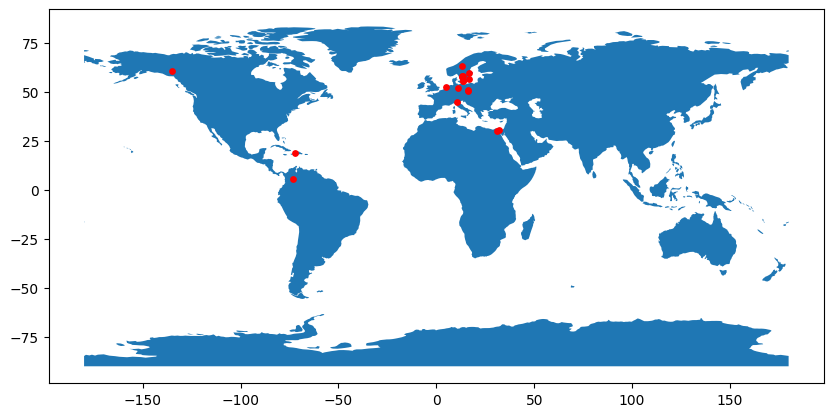

In [26]:
import pandas as pd
from shapely.geometry import Point
import geopandas as gpd
from geopandas import GeoDataFrame
import geodatasets

df = pd.read_csv("coordinates.csv", delimiter=',', skiprows=0, low_memory=False)

geometry = [Point(xy) for xy in zip(df['Longitude'], df['Latitude'])]
gdf = GeoDataFrame(df, geometry=geometry)   

#this is a simple map that goes with geopandas
# deprecated: world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
world = gpd.read_file(geodatasets.data.naturalearth.land['url'])
gdf.plot(ax=world.plot(figsize=(10, 6)), marker='o', color='red', markersize=15);

In [25]:
%pip install geodatasets